<a href="https://colab.research.google.com/github/LysanetsAndriy/HackDisaster/blob/main/HackDisaster.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
! mkdir /content/drive/MyDrive/CVAT/data

mkdir: cannot create directory ‘/content/drive/MyDrive/CVAT/data’: No such file or directory


In [ ]:
! unzip /content/drive/MyDrive/CVAT/Dataset_CVAT.zip -d /content/drive/MyDrive/CVAT/data

Archive:  /content/drive/MyDrive/CVAT/Dataset_CVAT.zip
replace /content/drive/MyDrive/CVAT/data/annotations.xml? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


# Import libraries

In [ ]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
from tqdm import tqdm
import xml.etree.ElementTree as ET
from PIL import Image, ImageDraw
from torch.utils.data import Dataset
import torchvision.transforms as T
from torchvision import transforms
import torch.nn.functional as F
from torch.utils.tensorboard import SummaryWriter
from torch.utils.data import random_split, DataLoader
from torch.optim.lr_scheduler import ReduceLROnPlateau
import numpy as np
import torch
import torch.optim as optim
import torch.nn as nn
from torchvision import models
from torchsummary import summary
from torch.amp import autocast, GradScaler

# Config

In [ ]:
class Config:
  #path
  data_dir = '/content/drive/MyDrive/CVAT/data'
  image_dir = os.path.join(data_dir, 'images', 'default')
  annotations_file = os.path.join(data_dir, 'annotations.xml')
  logdir = 'logdir'
  patched_dataset_dir = '/content/patch_dataset_zipped'
  gdrive_archive_path = '/content/drive/MyDrive/CVAT/patch_dataset_zipped.zip'

  #model
  num_epochs = 20
  train_batch = 96
  seed = 121224
  num_workers = 2
  device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
  pin_memory = True  # Speed up transfer to GPU

  #dataset
  patch_size=(300, 300)
  stride=150


In [ ]:
def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)

set_seed(Config.seed)

# Datset Parsing

In [ ]:
def parse_annotations(xml_file):
    """
    Parse the annotations XML file to extract unique labels, polygon, and box data.

    Args:
        xml_file (str): Path to the annotations XML file.

    Returns:
        tuple: A dictionary mapping each unique label to an integer,
               and a list of dictionaries containing image metadata and polygon/box data.
    """
    # Parse XML file
    tree = ET.parse(xml_file)
    root = tree.getroot()

    unique_labels = set()
    annotations = []

    # Iterate through each image and collect labels, polygons, and boxes
    for image in root.findall('image'):
        image_data = {
            'image_name': image.get('name'),
            'width': int(image.get('width')),
            'height': int(image.get('height')),
            'polygons': [],
            'boxes': []
        }

        # Collect polygons
        for polygon in image.findall('polygon'):
            label = polygon.get('label')
            if label:
                unique_labels.add(label)
                points = polygon.get('points')
                polygon_data = {
                    'label': label,
                    'points': points
                }
                image_data['polygons'].append(polygon_data)

        # Collect boxes
        for box in image.findall('box'):
            label = box.get('label')
            if label:
                unique_labels.add(label)
                xtl, ytl, xbr, ybr = map(float, [box.get('xtl'), box.get('ytl'), box.get('xbr'), box.get('ybr')])
                box_data = {
                    'label': label,
                    'xtl': xtl,
                    'ytl': ytl,
                    'xbr': xbr,
                    'ybr': ybr
                }
                image_data['boxes'].append(box_data)

        if image_data['polygons'] or image_data['boxes']:
            annotations.append(image_data)

    label_mapping = {label: idx + 1 for idx, label in enumerate(sorted(unique_labels))}
    return label_mapping, annotations


In [ ]:
label_mapping, annotations = parse_annotations(Config.annotations_file)

In [ ]:
print("Label Mapping:")
print(label_mapping)
print("\nSample Annotations:")
print(annotations[:2])

Label Mapping:
{'Broken Window': 1, 'Building': 2, 'Damage': 3, 'Damaged roof': 4, 'Other': 5, 'Roof': 6}

Sample Annotations:
[{'image_name': 'image1.png', 'width': 1848, 'height': 966, 'polygons': [{'label': 'Other', 'points': '769.14,261.71;774.29,258.29;774.29,239.43;801.71,230.86;794.86,205.14;890.86,188.00;890.86,150.29;1065.71,150.29;1058.86,230.86;1112.00,234.29;1831.96,-0.00;1479.66,0.00;770.86,1.14'}, {'label': 'Building', 'points': '798.80,208.74;802.23,239.60;776.51,244.74;778.23,265.31;767.94,263.60;783.37,875.60;1141.66,882.46;1146.80,810.46;1102.23,719.60;1114.23,241.31;1055.94,241.31;1059.37,152.17;894.80,157.31;896.51,193.31'}, {'label': 'Other', 'points': '1112.51,342.46;1103.94,719.60;1153.66,813.89;1143.37,889.31;778.23,879.03;769.70,966.00;771.80,966.00;1848.00,964.70;1844.51,736.74;1844.51,1.31;1112.51,237.89;1054.23,237.89;1115.94,239.60;1115.94,244.74'}, {'label': 'Damage', 'points': '1112.51,340.74;1045.66,342.46;1049.09,433.31;893.09,436.74;894.80,484.74;793.6

In [ ]:
def transform_boxes_to_polygons(annotations):
    """
    Transform bounding box annotations into a polygon-like format and add them to the dataset.

    Args:
        annotations (list): List of image annotations, each containing 'polygons' and 'boxes'.

    Returns:
        list: Updated annotations with boxes transformed into polygons.
    """
    updated_annotations = []

    for image_data in annotations:
        # Create a deep copy of image data to avoid modifying the original
        new_image_data = {
            'image_name': image_data['image_name'],
            'width': image_data['width'],
            'height': image_data['height'],
            'polygons': image_data['polygons'][:]
        }

        # Convert each box to polygon format and add to 'polygons' list
        for box in image_data.get('boxes', []):
            label = box['label']
            xtl, ytl, xbr, ybr = box['xtl'], box['ytl'], box['xbr'], box['ybr']

            # Define the four corners of the box
            box_points = f"{xtl},{ytl};{xbr},{ytl};{xbr},{ybr};{xtl},{ybr}"

            # Create a new polygon data dictionary
            box_as_polygon = {
                'label': label,
                'points': box_points
            }

            # Append the converted box (now as a polygon) to the polygons list
            new_image_data['polygons'].append(box_as_polygon)

        # Append the updated image data to the list
        updated_annotations.append(new_image_data)

    return updated_annotations


In [ ]:
# Apply the transformation to the annotations
annotations_with_polygons = transform_boxes_to_polygons(annotations)

print("Sample of transformed annotations with boxes as polygons:")
print(annotations_with_polygons[:2])
annotations = annotations_with_polygons

Sample of transformed annotations with boxes as polygons:
[{'image_name': 'image1.png', 'width': 1848, 'height': 966, 'polygons': [{'label': 'Other', 'points': '769.14,261.71;774.29,258.29;774.29,239.43;801.71,230.86;794.86,205.14;890.86,188.00;890.86,150.29;1065.71,150.29;1058.86,230.86;1112.00,234.29;1831.96,-0.00;1479.66,0.00;770.86,1.14'}, {'label': 'Building', 'points': '798.80,208.74;802.23,239.60;776.51,244.74;778.23,265.31;767.94,263.60;783.37,875.60;1141.66,882.46;1146.80,810.46;1102.23,719.60;1114.23,241.31;1055.94,241.31;1059.37,152.17;894.80,157.31;896.51,193.31'}, {'label': 'Other', 'points': '1112.51,342.46;1103.94,719.60;1153.66,813.89;1143.37,889.31;778.23,879.03;769.70,966.00;771.80,966.00;1848.00,964.70;1844.51,736.74;1844.51,1.31;1112.51,237.89;1054.23,237.89;1115.94,239.60;1115.94,244.74'}, {'label': 'Damage', 'points': '1112.51,340.74;1045.66,342.46;1049.09,433.31;893.09,436.74;894.80,484.74;793.66,484.74;791.94,558.46;774.80,558.46;783.37,875.60;1143.37,882.46;114

# Data visualization

In [ ]:
color_mapping = {
    1: (0, 0, 255, 128),      # Blue for 'Broken Window', semi-transparent
    2: (0, 255, 0, 64),      # Green for 'Building', semi-transparent
    3: (255, 0, 255, 64),    # Purpule for 'Damage', semi-transparent
    4: (255, 0, 0, 100),      # Red for 'Damaged roof', semi-transparent
    5: (211, 211, 211, 150),  # Light grey for 'Other', semi-transparent
    6: (255, 255, 0, 64),    # Yellow for 'Roof', semi-transparent
}

In [ ]:
def load_image(image_path):
    """
    Load an image from the specified path and return it as a PIL image.

    Args:
        image_path (str): Path to the image file.

    Returns:
        PIL.Image: Loaded image.
    """
    return Image.open(image_path).convert("RGB")

In [ ]:
def create_mask(image_data, label_mapping, width, height):
    """
    Create a binary mask for a single image based on the polygon annotations.

    Args:
        image_data (dict): Annotation data for a single image, containing polygon coordinates.
        label_mapping (dict): Mapping of labels to integer values for mask encoding.
        width (int): Width of the mask (same as image width).
        height (int): Height of the mask (same as image height).

    Returns:
        numpy.array: Mask with polygons drawn for segmentation.
    """
    # Other, Building, Roof, Damage, Damaged Roof, Broken Window
    priority_order = {
        "Broken Window": 6,
        "Damaged roof": 5,
        "Damage": 4,
        "Roof": 3,
        "Building": 2,
        "Other": 1
    }

    # Sort polygons by priority (lower priority values are drawn first)
    sorted_polygons = sorted(image_data['polygons'], key=lambda p: priority_order.get(p['label']))

    mask = Image.new("RGBA", (width, height), (0, 0, 0, 0))  # Create an empty mask

    labels = []

    for polygon in sorted_polygons:
        label = polygon['label']
        points = polygon['points']
        points = [tuple(map(float, p.split(','))) for p in points.split(';')]

        labels.append(label)

        color = color_mapping[label_mapping[label]]

        # Draw polygon on the mask
        draw = ImageDraw.Draw(mask, "RGBA")
        draw.polygon(points, fill=color)
    print(labels)
    return np.array(mask)

In [ ]:
def visualize_samples(annotations, label_mapping, num_samples=1):
    """
    Visualize a few samples from the dataset with their annotations overlayed.

    Args:
        annotations (list): List of image annotations.
        label_mapping (dict): Dictionary mapping labels to integers.
        num_samples (int): Number of samples to visualize.
    """
    plt.figure(figsize=(15, num_samples * 5))

    for i, image_data in enumerate(random.sample(annotations, num_samples)):
        image_path = os.path.join(Config.image_dir, image_data['image_name'])
        image = load_image(image_path)
        mask = create_mask(image_data, label_mapping, image.width, image.height)

        plt.subplot(num_samples, 1, i * 2 + 1)
        plt.imshow(image)
        # plt.title(f"Original Image: {image_data['image_name']}")
        plt.imshow(mask, alpha=0.7)
        plt.axis("off")

    plt.tight_layout()
    plt.show()


In [ ]:
print(annotations[6])

{'image_name': 'image7.png', 'width': 1848, 'height': 966, 'polygons': [{'label': 'Damage', 'points': '659.38,796.39;664.52,828.94;721.04,832.36;719.32,804.96'}, {'label': 'Roof', 'points': '482.97,167.83;510.37,126.73;563.47,118.17;575.46,118.17;585.73,101.04;613.14,102.75;640.54,95.90;664.52,87.34;724.46,82.20;734.74,59.94;748.44,73.64;834.07,42.81;900.87,49.66;918.00,58.22;953.96,58.22;957.39,46.23;964.24,61.65;1000.21,65.07;1007.06,46.23;1031.03,47.95;1031.03,59.94;1061.86,61.65;1031.03,61.65;1010.48,44.52;1000.21,63.36;960.81,59.94;916.28,61.65;894.02,46.23;832.36,46.23;743.30,77.06;724.46,82.20;662.80,87.34;638.83,90.76;608.00,104.47;584.02,104.47;573.74,119.88;506.95,128.44'}, {'label': 'Damage', 'points': '676.51,363.08;676.51,411.04;731.31,411.04;729.60,366.51'}, {'label': 'Broken Window', 'points': '491.53,510.37;494.96,525.79;529.21,534.35;542.92,534.35;541.20,518.94'}, {'label': 'Broken Window', 'points': '491.53,381.92;486.40,400.76;566.89,399.05;597.72,392.20;628.55,393.9

['Other', 'Other', 'Other', 'Other', 'Building', 'Damage']


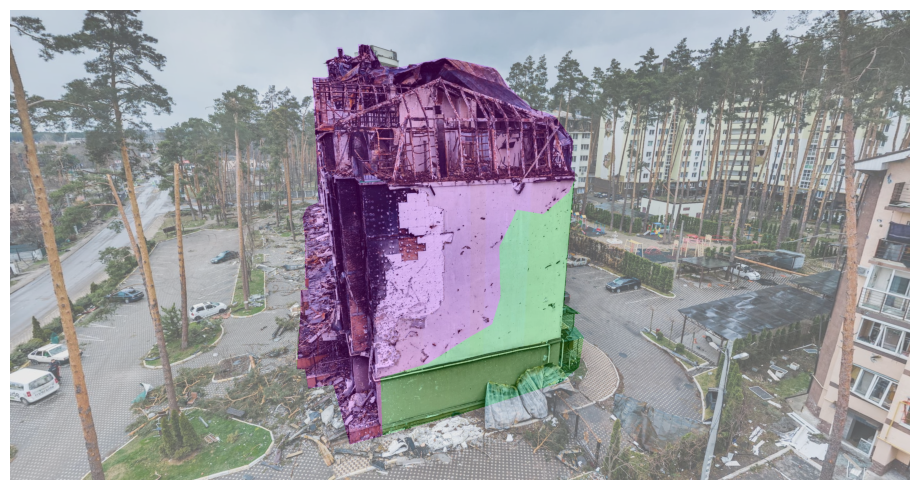

In [ ]:
visualize_samples(annotations, label_mapping)

Broken Window: **Blue**, Building: **Green**, Damage: **Purple**, Damaged roof: **Red**, Other: **Grey**, Roof: **Orange**



---



# Create label mask

In [ ]:
def create_label_mask(image_data, label_mapping, width, height):
    """
    Create an integer label mask for a single image, where each pixel's value
    corresponds to the class ID.

    Args:
        image_data (dict): Annotation data for a single image, containing polygon coordinates.
        label_mapping (dict): Mapping of labels to integer values.
        width (int): Width of the mask (same as image width).
        height (int): Height of the mask (same as image height).

    Returns:
        numpy.array: Integer mask where each pixel contains the class ID (1 to 6).
    """
    # Other, Building, Roof, Damage, Damaged Roof, Broken Window
    priority_order = {
        "Broken Window": 6,
        "Damaged roof": 5,
        "Damage": 4,
        "Roof": 3,
        "Building": 2,
        "Other": 1
    }

    # Sort polygons by priority (lower priority values are drawn first)
    sorted_polygons = sorted(image_data['polygons'], key=lambda p: priority_order.get(p['label']))

    # Initialize mask with zeros (background)
    mask = np.zeros((height, width), dtype=np.int32)

    for polygon in sorted_polygons:
        label = polygon['label']
        points = polygon['points']
        points = [tuple(map(float, p.split(','))) for p in points.split(';')]

        # Get the class ID for the label
        class_id = label_mapping[label]

        # Draw polygon with the corresponding class ID
        pil_mask = Image.fromarray(mask)
        draw = ImageDraw.Draw(pil_mask)
        draw.polygon(points, fill=class_id)
        mask = np.array(pil_mask)  # Update mask

    return mask


In [ ]:
def visualize_label_masks(samples, label_mapping, image_dir, mask_height, mask_width):
    """
    Visualize label masks for a set of sample data examples.

    Args:
        samples (list): A list of sample annotations to visualize (e.g., `annotations[:5]`).
        label_mapping (dict): Dictionary mapping labels to integer IDs.
        image_dir (str): Directory containing the images.
        mask_height (int): Height of the mask (should match the image height).
        mask_width (int): Width of the mask (should match the image width).
    """
    plt.figure(figsize=(15, len(samples)*5))

    for idx, sample in enumerate(samples):
        # Load image
        image_path = os.path.join(image_dir, sample['image_name'])
        image = Image.open(image_path).convert("RGB")

        # Generate label mask for the sample
        mask = create_label_mask(sample, label_mapping, mask_width, mask_height)
        # Plot image and mask
        plt.subplot(len(samples), 2, idx * 2 + 1)
        plt.imshow(image)
        plt.title(f"Original Image: {sample['image_name']}")
        plt.axis('off')

        plt.subplot(len(samples), 2, idx * 2 + 2)
        plt.imshow(mask, cmap='nipy_spectral')
        plt.title("Label Mask")
        plt.axis('off')

    plt.tight_layout()
    plt.show()


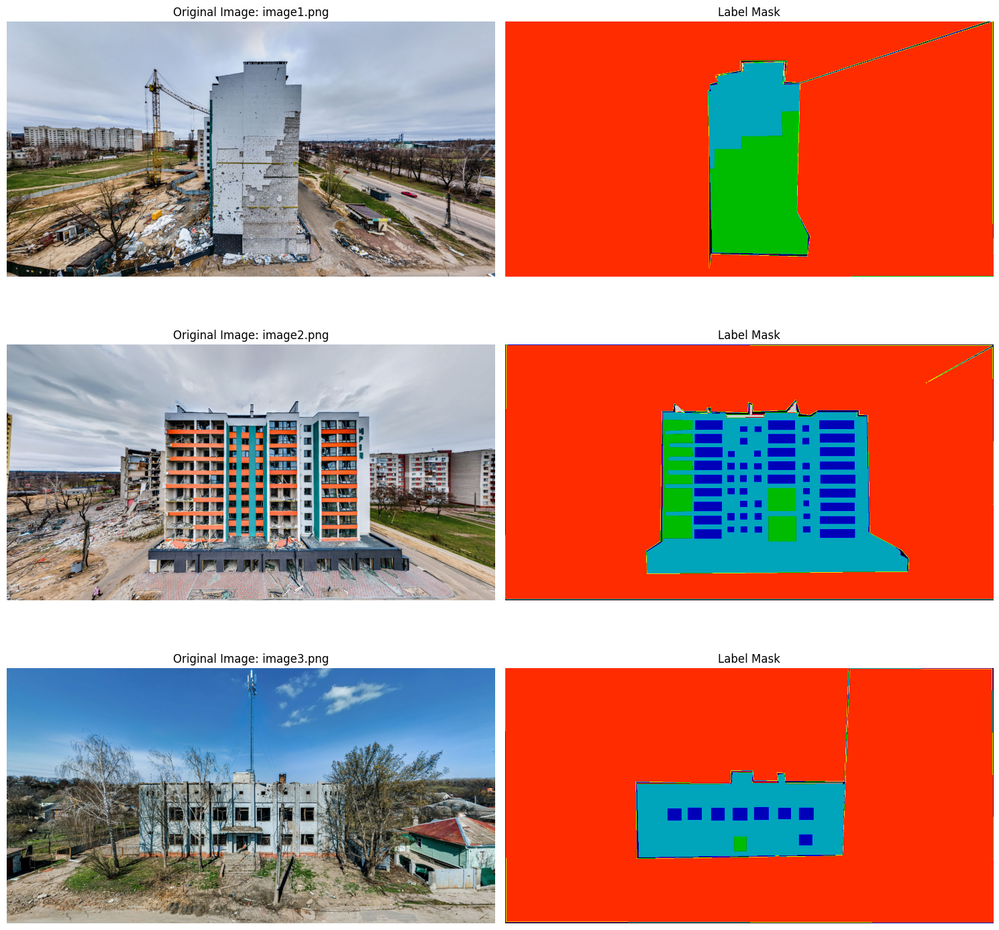

In [ ]:
# Select some samples for visualization
sample_annotations = annotations[0:3]  # Change this to display more or fewer examples

# Assume all images have the same width and height; otherwise, you’ll need to handle each size.
sample_width = sample_annotations[0]['width']
sample_height = sample_annotations[0]['height']

# Visualize label masks
visualize_label_masks(sample_annotations, label_mapping, Config.image_dir, sample_height, sample_width)


{'Broken Window': 1, 'Building': 2, 'Damage': 3, 'Damaged roof': 4, 'Other': 5, 'Roof': 6}

# Create Patch dataset

In [ ]:
def save_patched_dataset(annotations, image_dir, label_mapping, output_dir,
                         patch_size=(256, 256), stride=128):
    """
    Save image and mask patches as separate files in a specified folder.

    Args:
        annotations (list): Parsed annotations containing polygon data.
        image_dir (str): Directory containing the original images.
        label_mapping (dict): Mapping of label names to integers.
        output_dir (str): Directory where patches will be stored.
        patch_size (tuple): Size of each patch (width, height).
        stride (int): Step size for sliding window.

    Returns:
        None
    """
    os.makedirs(output_dir, exist_ok=True)

    patch_index = 0  # Index to uniquely name patches

    for sample in tqdm(annotations, desc="Processing Images"):
        # Load the image and mask
        image_path = os.path.join(image_dir, sample['image_name'])
        image = Image.open(image_path).convert("RGB")
        width, height = image.size
        mask = create_label_mask(sample, label_mapping, width, height)

        # Convert to numpy arrays
        image_np = np.array(image)
        mask_np = np.array(mask)

        # Pad the image and mask to handle edges
        pad_w = (patch_size[0] - width % stride) % stride
        pad_h = (patch_size[1] - height % stride) % stride
        image_np = np.pad(image_np, ((0, pad_h), (0, pad_w), (0, 0)), mode='constant')
        mask_np = np.pad(mask_np, ((0, pad_h), (0, pad_w)), mode='constant')

        padded_height, padded_width = image_np.shape[:2]

        # Slide over the image with a window
        for y in range(0, padded_height - patch_size[1] + 1, stride):
            for x in range(0, padded_width - patch_size[0] + 1, stride):
                # Extract patches
                image_patch = image_np[y:y + patch_size[1], x:x + patch_size[0], :]
                mask_patch = mask_np[y:y + patch_size[1], x:x + patch_size[0]]

                # Save image and mask patches in a single zipped npz file
                patch_path = os.path.join(output_dir, f"patch_{patch_index}.npz")
                np.savez_compressed(patch_path, image=image_patch, mask=mask_patch)

                patch_index += 1

    print(f"Patched dataset saved as npz files to: {output_dir}")


In [ ]:
output_dir = "/content/drive/MyDrive/CVAT/patch_dataset_zipped"

# Save the patched dataset
# save_patched_dataset(
#     annotations=annotations,
#     image_dir=Config.image_dir,
#     label_mapping=label_mapping,
#     output_dir=output_dir,
#     patch_size=Config.patch_size,
#     stride=Config.stride,
# )


In [ ]:
import shutil

folder_to_zip = '/content/drive/MyDrive/CVAT/patch_dataset_zipped'
output_zip = '/content/drive/MyDrive/CVAT/patch_dataset_zipped.zip'

# # Create the zip file
# shutil.make_archive(
#     base_name=output_zip.replace('.zip', ''),  # Remove '.zip' extension for shutil
#     format='zip',  # Compression format
#     root_dir=folder_to_zip  # Folder to zip
# )

# print(f"Dataset zipped successfully at: {output_zip}")


In [ ]:
if os.path.exists(output_zip):
    print(f"Archive created: {output_zip}")
else:
    print("Error: Archive creation failed!")


Archive created: /content/drive/MyDrive/CVAT/patch_dataset_zipped.zip


In [ ]:
# Destination path in the Colab environment
colab_archive_path = '/content/patch_dataset_zipped.zip'

# Copy the file to Colab
shutil.copy(Config.gdrive_archive_path, colab_archive_path)

print(f"Archive copied to Colab: {colab_archive_path}")

Archive copied to Colab: /content/patch_dataset_zipped.zip


In [ ]:
unzip_folder = '/content/patch_dataset_zipped'

# Unzip the archive
shutil.unpack_archive(colab_archive_path, unzip_folder, 'zip')

print(f"Archive unzipped to: {unzip_folder}")

Archive unzipped to: /content/patch_dataset_zipped


# DataSet

In [ ]:
class PatchedDataset(Dataset):
    def __init__(self, patch_dir, transform=None):
        self.patch_files = sorted(os.listdir(patch_dir))
        self.patch_dir = patch_dir
        self.transform = transform

    def __len__(self):
        return len(self.patch_files)

    def __getitem__(self, idx):
        patch_path = os.path.join(self.patch_dir, self.patch_files[idx])

        patch = np.load(patch_path)

        image = Image.fromarray(patch['image'])
        mask = patch['mask']

        if self.transform is not None:
            image = self.transform(image)
        else:
            image = transforms.ToTensor()(image)
            image = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                         std=[0.229, 0.224, 0.225])(image)

        mask = torch.from_numpy(mask).long()
        return image, mask

In [ ]:
patched_dataset = PatchedDataset(
    patch_dir=Config.patched_dataset_dir
)

In [ ]:
def display_patched_dataset_item(patched_dataset, idx):
    """
    Display an image and its corresponding mask from the patched dataset.

    Args:
        patched_dataset (Dataset): Instance of the patched dataset.
        idx (int): Index of the item to display.

    Returns:
        None
    """
    # Get the image and mask
    image, mask = patched_dataset[idx]  # image: tensor, mask: tensor

    # Convert image tensor to NumPy array for visualization
    std = np.array([0.229, 0.224, 0.225])
    std = std.reshape((1,1,3))
    mean = np.array([0.485, 0.456, 0.406])
    mean = mean.reshape((1,1,3))


    image_np = image.permute(1, 2, 0).numpy()  # Convert [C, H, W] -> [H, W, C]
    image_np = image_np * std + mean
    image_np = np.clip(image_np, 0, 1)  # Ensure pixel values are in range [0, 1]

    # Convert mask tensor to NumPy array
    mask_np = mask.numpy()

    # Plot the image and mask side by side
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    axes[0].imshow(image_np)
    axes[0].set_title("Image")
    axes[0].axis("off")

    axes[1].imshow(mask_np, cmap="nipy_spectral")
    axes[1].set_title("Mask")
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()

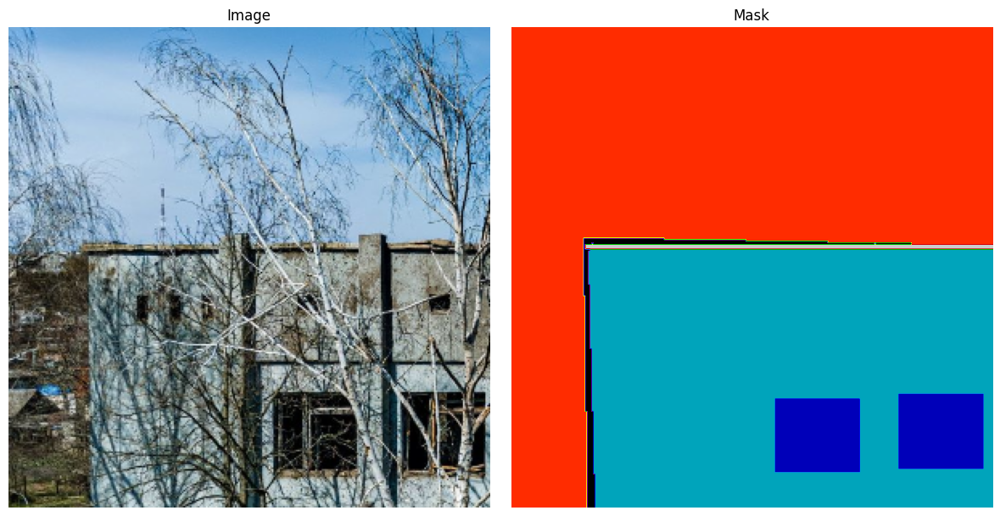

In [ ]:
id = np.random.randint(len(patched_dataset))
display_patched_dataset_item(patched_dataset, idx=id)

# DataLoader

In [ ]:
# Define split ratios
train_ratio = 0.8
val_ratio= 0.1
test_ratio = 0.1

# Ensure ratios add up to 1.0
assert abs(train_ratio + test_ratio + val_ratio - 1.0) < 1e-6, "Split ratios must sum to 1.0"

# Calculate lengths for train, validation, and test sets
total_length = len(patched_dataset)
train_size = int(train_ratio * total_length)
test_size = int(test_ratio * total_length)
val_size = total_length - train_size - test_size  # Remaining samples for validation

# Perform the split
train_dataset, test_dataset, val_dataset = random_split(
    patched_dataset,
    [train_size, test_size, val_size]
)

# Create DataLoaders for training, validation, and testing sets
train_dataloader = DataLoader(
    train_dataset,
    batch_size=Config.train_batch,  # Batch size for training
    shuffle=True,                   # Shuffle training data
    num_workers=Config.num_workers,
    pin_memory=Config.pin_memory                 # Speed up transfer to GPU if available
)

val_dataloader = DataLoader(
    val_dataset,
    batch_size=Config.train_batch,  # Batch size for validation
    shuffle=False,                  # No need to shuffle validation data
    num_workers=Config.num_workers,
    pin_memory=Config.pin_memory
)

test_dataloader = DataLoader(
    test_dataset,
    batch_size=Config.train_batch,  # Batch size for testing
    shuffle=False,                  # No need to shuffle testing data
    num_workers=Config.num_workers,
    pin_memory=Config.pin_memory
)

# Example output to verify the splits
print(f"Total dataset size: {total_length}")
print(f"Train set size: {len(train_dataset)}")
print(f"Validation set size: {len(val_dataset)}")
print(f"Test set size: {len(test_dataset)}")


Total dataset size: 18535
Train set size: 14828
Validation set size: 1854
Test set size: 1853


In [ ]:
print(len(patched_dataset))
print(train_size)

18535
14828


# UNet model

In [ ]:
class UNetTransferLearning(nn.Module):
    def __init__(self, num_classes):
        super(UNetTransferLearning, self).__init__()
        """
        Initialize the U-Net model with a pre-trained ResNet34 encoder.

        Args:
            num_classes (int): Number of output classes for segmentation.
        """
        self.num_classes = num_classes
        # Load a pre-trained ResNet18 model as the encoder
        resnet = models.resnet18(pretrained=True)

        # Extract layers from ResNet18 to use as the encoder
        self.encoder1 = nn.Sequential(resnet.conv1, resnet.bn1, resnet.relu)  # [64, H/2, W/2]
        self.pool1 = resnet.maxpool  # [64, H/4, W/4]
        self.encoder2 = resnet.layer1  # [64, H/4, W/4]
        self.encoder3 = resnet.layer2  # [128, H/8, W/8]
        self.encoder4 = resnet.layer3  # [256, H/16, W/16]
        self.encoder5 = resnet.layer4  # [512, H/32, W/32]

        # Decoder layers
        self.upconv5 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)  # [256, H/16, W/16]
        self.decoder5 = self.conv_block(512, 256)  # Concatenated channels: 256 + 256 = 512

        self.upconv4 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)  # [128, H/8, W/8]
        self.decoder4 = self.conv_block(256, 128)  # Concatenated channels: 128 + 128 = 256

        self.upconv3 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)  # [64, H/4, W/4]
        self.decoder3 = self.conv_block(128, 64)  # Concatenated channels: 64 + 64 = 128

        self.upconv2 = nn.ConvTranspose2d(64, 64, kernel_size=2, stride=2)  # [64, H/2, W/2]
        self.decoder2 = self.conv_block(128, 64)  # Concatenated channels: 64 + 64 = 128

        self.upconv1 = nn.ConvTranspose2d(64, 64, kernel_size=2, stride=2)  # [64, H, W]
        # Removed the skip connection with the input image 'x'
        self.decoder1 = self.conv_block(64, 64)  # No concatenation; channels remain 64

        # Final classifier to map features to class scores
        self.conv_last = nn.Conv2d(64, self.num_classes, kernel_size=1)  # [num_classes, H, W]

        self.freeze_unet(freeze_encoder=True)

    def freeze_unet(self, freeze_encoder=True, freeze_decoder=False):
        """
        Freeze or unfreeze parts of the U-Net model.

        Args:
            freeze_encoder (bool): If True, encoder layers are frozen.
            freeze_decoder (bool): If True, decoder layers are frozen.
        """
        # Freeze encoder layers if specified
        if freeze_encoder:
            for param in self.encoder1.parameters():
                param.requires_grad = True
            for param in self.encoder2.parameters():
                param.requires_grad = False
            for param in self.encoder3.parameters():
                param.requires_grad = False
            for param in self.encoder4.parameters():
                param.requires_grad = False
            for param in self.encoder5.parameters():
                param.requires_grad = True

        # Freeze decoder layers if specified
        if freeze_decoder:
            for param in self.upconv5.parameters():
                param.requires_grad = False
            for param in self.decoder5.parameters():
                param.requires_grad = False
            for param in self.upconv4.parameters():
                param.requires_grad = False
            for param in self.decoder4.parameters():
                param.requires_grad = False
            for param in self.upconv3.parameters():
                param.requires_grad = False
            for param in self.decoder3.parameters():
                param.requires_grad = False
            for param in self.upconv2.parameters():
                param.requires_grad = False
            for param in self.decoder2.parameters():
                param.requires_grad = False
            for param in self.upconv1.parameters():
                param.requires_grad = False
            for param in self.decoder1.parameters():
                param.requires_grad = False
            for param in self.conv_last.parameters():
                param.requires_grad = False

    def forward(self, x):
        """
        Forward pass of the U-Net model.

        Args:
            x (torch.Tensor): Input tensor of shape [batch_size, 3, H, W]

        Returns:
            torch.Tensor: Output tensor of shape [batch_size, num_classes, H, W]
        """
        # Encoder path
        enc1 = self.encoder1(x)                  # [batch, 64, H/2, W/2]
        enc2 = self.encoder2(self.pool1(enc1))   # [batch, 64, H/4, W/4]
        enc3 = self.encoder3(enc2)               # [batch, 128, H/8, W/8]
        enc4 = self.encoder4(enc3)               # [batch, 256, H/16, W/16]
        enc5 = self.encoder5(enc4)               # [batch, 512, H/32, W/32]

        # Decoder path with skip connections
        dec5 = self.upconv5(enc5)                # [batch, 256, H/16, W/16]
        # Ensure spatial dimensions match before concatenation
        dec5 = F.interpolate(dec5, size=enc4.shape[2:], mode='bilinear', align_corners=True)
        dec5 = torch.cat((dec5, enc4), dim=1)    # [batch, 256 + 256, H/16, W/16]
        dec5 = self.decoder5(dec5)               # [batch, 256, H/16, W/16]

        dec4 = self.upconv4(dec5)                # [batch, 128, H/8, W/8]
        dec4 = F.interpolate(dec4, size=enc3.shape[2:], mode='bilinear', align_corners=True)
        dec4 = torch.cat((dec4, enc3), dim=1)    # [batch, 128 + 128, H/8, W/8]
        dec4 = self.decoder4(dec4)               # [batch, 128, H/8, W/8]

        dec3 = self.upconv3(dec4)                # [batch, 64, H/4, W/4]
        dec3 = F.interpolate(dec3, size=enc2.shape[2:], mode='bilinear', align_corners=True)
        dec3 = torch.cat((dec3, enc2), dim=1)    # [batch, 64 + 64, H/4, W/4]
        dec3 = self.decoder3(dec3)               # [batch, 64, H/4, W/4]

        dec2 = self.upconv2(dec3)                # [batch, 64, H/2, W/2]
        dec2 = F.interpolate(dec2, size=enc1.shape[2:], mode='bilinear', align_corners=True)
        dec2 = torch.cat((dec2, enc1), dim=1)    # [batch, 64 + 64, H/2, W/2]
        dec2 = self.decoder2(dec2)               # [batch, 64, H/2, W/2]

        dec1 = self.upconv1(dec2)                # [batch, 64, H, W]
        # Removed the skip connection with the input image 'x'
        dec1 = self.decoder1(dec1)               # [batch, 64, H, W]

        # Final output layer
        out = self.conv_last(dec1)               # [batch, num_classes, H, W]

        return out

    def conv_block(self, in_channels, out_channels):
        """
        Convolutional block consisting of Conv -> BatchNorm -> ReLU.

        Args:
            in_channels (int): Number of input channels.
            out_channels (int): Number of output channels.

        Returns:
            nn.Sequential: Convolutional block.
        """
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )


In [ ]:
# Number of classes (including background if applicable)
num_classes = len(label_mapping) + 1  # Add 1 if background is class 0

# Initialize the model
model = UNetTransferLearning(num_classes=num_classes).to(Config.device)
summary(model, input_size=(3, 256, 256))

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 161MB/s]


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           9,408
       BatchNorm2d-2         [-1, 64, 128, 128]             128
              ReLU-3         [-1, 64, 128, 128]               0
         MaxPool2d-4           [-1, 64, 64, 64]               0
            Conv2d-5           [-1, 64, 64, 64]          36,864
       BatchNorm2d-6           [-1, 64, 64, 64]             128
              ReLU-7           [-1, 64, 64, 64]               0
            Conv2d-8           [-1, 64, 64, 64]          36,864
       BatchNorm2d-9           [-1, 64, 64, 64]             128
             ReLU-10           [-1, 64, 64, 64]               0
       BasicBlock-11           [-1, 64, 64, 64]               0
           Conv2d-12           [-1, 64, 64, 64]          36,864
      BatchNorm2d-13           [-1, 64, 64, 64]             128
             ReLU-14           [-1, 64,

# Metrics

In [ ]:
def calculate_pixel_accuracy(pred, true):
  """
    Calculate pixel-wise accuracy.

    Args:
        pred (np.ndarray): Predicted mask of shape (H, W).
        true (np.ndarray): True mask of shape (H, W).

    Returns:
        float: Pixel-wise accuracy.
  """
  correct_pixels = np.sum(pred == true)
  total_pixels = true.size
  return correct_pixels / total_pixels

In [ ]:
def calculate_iou(pred, true, num_classes):
  """
  Calculate Intersection over Union (IoU) for all classes.

    Args:
        pred (np.ndarray): Predicted mask of shape (H, W).
        true (np.ndarray): True mask of shape (H, W).
        num_classes (int): Total number of classes.

    Returns:
        np.ndarray: IoU score for each class.
  """
  ious = []
  for cls in range(num_classes):
    intersection = np.logical_and(pred == cls, true == cls).sum()
    union = np.logical_or(pred == cls, true == cls).sum()
    if union == 0:
      ious.append(float('nan'))
    else:
      ious.append(intersection / union)
  return np.array(ious)

In [ ]:
def calculate_dice(pred, true, num_classes):
  """
    Calculate Dice Coefficient for all classes.

    Args:
        pred (np.ndarray): Predicted mask of shape (H, W).
        true (np.ndarray): True mask of shape (H, W).
        num_classes (int): Total number of classes.

    Returns:
        np.ndarray: Dice score for each class.
  """
  dice_scores = []
  for cls in range(num_classes):
    intersection = np.logical_and(pred == cls, true == cls).sum()
    pred_sum = (pred == cls).sum()
    true_sum = (true == cls).sum()
    if pred_sum + true_sum == 0:
      dice_scores.append(float('nan'))
    else:
      dice_scores.append(2 * intersection / (pred_sum + true_sum))
  return np.array(dice_scores)

# Trian Loop and Eval Loop

In [ ]:
def train_loop(model, optimizer, criterion, train_loader, scaler, device=Config.device):
    """
    Training loop for the segmentation model with metrics calculation.

    Args:
        model (nn.Module): The segmentation model.
        optimizer (torch.optim.Optimizer): Optimizer for updating model weights.
        criterion (nn.Module): Loss function.
        train_loader (DataLoader): DataLoader for training data.
        scaler (GradScaler): GradScaler for mixed precision training.
        device (torch.device): Device to perform training on.

    Returns:
        dict: Dictionary containing average training loss, pixel accuracy, IoU, and Dice scores.
    """
    model.train()
    running_loss = 0.0
    total_pixel_accuracy = 0
    iou_list = []
    dice_list = []
    num_images = 0

    pbar = tqdm(train_loader, desc='Training Epoch')

    for imgs, masks in pbar:
        imgs, masks = imgs.to(device), masks.to(device)

        optimizer.zero_grad()
        with autocast('cuda'):
            outputs = model(imgs)
            loss = criterion(outputs, masks)

        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        running_loss += loss.item() * imgs.size(0)

        preds = torch.argmax(outputs, dim=1).cpu().numpy()
        masks = masks.cpu().numpy()

        for pred, true_mask in zip(preds, masks):
            pixel_accuracy = calculate_pixel_accuracy(pred, true_mask)
            iou = calculate_iou(pred, true_mask, model.num_classes)
            dice = calculate_dice(pred, true_mask, model.num_classes)

            total_pixel_accuracy += pixel_accuracy
            iou_list.append(iou)
            dice_list.append(dice)
            num_images += 1

        pbar.set_postfix({'Loss': loss.item()})

    epoch_loss = running_loss / len(train_loader.dataset)
    avg_pixel_accuracy = total_pixel_accuracy / num_images
    avg_iou = np.nanmean(iou_list, axis=0)
    avg_dice = np.nanmean(dice_list, axis=0)

    return {
        'loss': epoch_loss,
        'pixel_accuracy': avg_pixel_accuracy,
        'iou': avg_iou,
        'dice': avg_dice
    }

In [ ]:
def eval_loop(model, criterion, eval_loader, device=Config.device):
    """
    Evaluation loop for the segmentation model with metrics calculation.

    Args:
        model (nn.Module): The segmentation model.
        criterion (nn.Module): Loss function.
        eval_loader (DataLoader): DataLoader for evaluation data.
        device (torch.device): Device to perform evaluation on.

    Returns:
        dict: Dictionary containing average evaluation loss, pixel accuracy, IoU, and Dice scores.
    """
    model.eval()
    running_loss = 0.0
    total_pixel_accuracy = 0
    iou_list = []
    dice_list = []
    num_images = 0

    with torch.no_grad():
        pbar = tqdm(eval_loader, desc='Evaluating')
        for imgs, masks in pbar:
            imgs, masks = imgs.to(device), masks.to(device)
            with autocast('cuda'):
                outputs = model(imgs)
                loss = criterion(outputs, masks)

            running_loss += loss.item() * imgs.size(0)

            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            masks = masks.cpu().numpy()

            for pred, true_mask in zip(preds, masks):
                pixel_accuracy = calculate_pixel_accuracy(pred, true_mask)
                iou = calculate_iou(pred, true_mask, model.num_classes)
                dice = calculate_dice(pred, true_mask, model.num_classes)

                total_pixel_accuracy += pixel_accuracy
                iou_list.append(iou)
                dice_list.append(dice)
                num_images += 1

            pbar.set_postfix({'Eval Loss': loss.item()})

    epoch_loss = running_loss / len(eval_loader.dataset)
    avg_pixel_accuracy = total_pixel_accuracy / num_images
    avg_iou = np.nanmean(iou_list, axis=0)
    avg_dice = np.nanmean(dice_list, axis=0)

    return {
        'loss': epoch_loss,
        'pixel_accuracy': avg_pixel_accuracy,
        'iou': avg_iou,
        'dice': avg_dice
    }

In [ ]:
def visualize_masks(model, valid_loader, device, color_mapping, classes, num_samples=3):
    """
    Visualize predicted masks alongside the original images and ground truth masks,
    using a custom color mapping.

    Args:
        model (nn.Module): The segmentation model.
        valid_loader (DataLoader): DataLoader for validation data.
        device (torch.device): Device to perform computation on.
        color_mapping (dict): Mapping of class indices to RGBA color tuples.
        classes (dict): Mapping of class names to indices.
        num_samples (int, optional): Number of samples to visualize. Defaults to 3.
    """
    model.eval()
    samples_visualized = 0
    plt.figure(figsize=(15, num_samples * 5))

    def apply_color_mapping(mask, color_mapping):
        """Apply color mapping to a mask."""
        colored_mask = np.zeros((*mask.shape, 4), dtype=np.uint8)  # RGBA
        for class_idx, color in color_mapping.items():
            colored_mask[mask == class_idx] = color
        return colored_mask

    with torch.no_grad():
        for imgs, masks in valid_loader:
            imgs = imgs.to(device).float()
            masks = masks.to(device).long()

            outputs = model(imgs)  # [batch_size, num_classes, H, W]
            preds = torch.argmax(outputs, dim=1)  # [batch_size, H, W]

            for i in range(imgs.size(0)):
                if samples_visualized >= num_samples:
                    break

                # Reverse normalization for the image
                image = imgs[i].cpu().numpy().transpose(1, 2, 0)
                image = np.clip(image * np.array([0.229, 0.224, 0.225]) +
                                np.array([0.485, 0.456, 0.406]), 0, 1)

                mask = masks[i].cpu().numpy()
                pred = preds[i].cpu().numpy()

                # Apply color mapping to ground truth and prediction masks
                gt_colored = apply_color_mapping(mask, color_mapping)
                pred_colored = apply_color_mapping(pred, color_mapping)

                # Plot original image
                plt.subplot(num_samples, 3, samples_visualized * 3 + 1)
                plt.imshow(image)
                plt.title("Original Image")
                plt.axis("off")

                # Plot ground truth mask
                plt.subplot(num_samples, 3, samples_visualized * 3 + 2)
                plt.imshow(gt_colored)
                plt.title("Ground Truth Mask")
                plt.axis("off")

                # Plot predicted mask
                plt.subplot(num_samples, 3, samples_visualized * 3 + 3)
                plt.imshow(pred_colored)
                plt.title("Predicted Mask")
                plt.axis("off")

                samples_visualized += 1

            if samples_visualized >= num_samples:
                break

    plt.tight_layout()
    plt.show()
    model.train()


In [ ]:
def train(model, optimizer, criterion, train_loader, valid_loader,
          device=Config.device,
          num_epochs=Config.num_epochs,
          valid_loss_min=np.inf,
          logdir=Config.logdir):
    """
    Train the segmentation model with validation and early stopping.

    Args:
        model (nn.Module): The segmentation model (e.g., UNetTransferLearning).
        optimizer (torch.optim.Optimizer): Optimizer for updating model weights.
        criterion (nn.Module): Loss function (e.g., nn.CrossEntropyLoss).
        train_loader (DataLoader): DataLoader for training data.
        valid_loader (DataLoader): DataLoader for validation data.
        early_stopping (EarlyStopping): Early stopping object to halt training.
        device (torch.device, optional): Device to perform training on. Defaults to Config.device.
        num_epochs (int, optional): Number of training epochs. Defaults to Config.num_epochs.
        valid_loss_min (float, optional): Minimum validation loss to track. Defaults to np.inf.
        logdir (str, optional): Directory for TensorBoard logs. Defaults to Config.logdir.

    Returns:
        None
    """
    # Initialize TensorBoard writer
    tb_writer = SummaryWriter(log_dir=logdir)
    scaler = GradScaler('cuda')

    # Initialize the learning rate scheduler
    scheduler = ReduceLROnPlateau(optimizer, mode='min', patience=5, factor=0.1, verbose=True)

    metrics_history = {
        'train_loss': [],
        'valid_loss': [],
        'train_pixel_accuracy': [],
        'valid_pixel_accuracy': [],
        'train_iou': [],
        'valid_iou': [],
        'train_dice': [],
        'valid_dice': []
    }

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")

        # Training phase
        train_metrics = train_loop(
            model, optimizer, criterion, train_loader, scaler, device=device
        )

        # Validation phase
        eval_metrics = eval_loop(
            model, criterion, valid_loader, device=device
        )

        # Logging
        print(f"Train Loss: {train_metrics['loss']:.4f}, Pixel Accuracy: {train_metrics['pixel_accuracy']:.4f}")
        print(f"Valid Loss: {eval_metrics['loss']:.4f}, Pixel Accuracy: {eval_metrics['pixel_accuracy']:.4f}")

        # Add metrics to TensorBoard
        tb_writer.add_scalar('Loss/Train', train_metrics['loss'], epoch)
        tb_writer.add_scalar('Loss/Validation', eval_metrics['loss'], epoch)
        tb_writer.add_scalar('Pixel Accuracy/Train', train_metrics['pixel_accuracy'], epoch)
        tb_writer.add_scalar('Pixel Accuracy/Validation', eval_metrics['pixel_accuracy'], epoch)

        # Store metrics for future plotting
        metrics_history['train_loss'].append(train_metrics['loss'])
        metrics_history['valid_loss'].append(eval_metrics['loss'])
        metrics_history['train_pixel_accuracy'].append(train_metrics['pixel_accuracy'])
        metrics_history['valid_pixel_accuracy'].append(eval_metrics['pixel_accuracy'])
        metrics_history['train_iou'].append(train_metrics['iou'])
        metrics_history['valid_iou'].append(eval_metrics['iou'])
        metrics_history['train_dice'].append(train_metrics['dice'])
        metrics_history['valid_dice'].append(eval_metrics['dice'])

        # Step the scheduler based on validation loss
        scheduler.step(eval_metrics["loss"])

        # Save the model if validation loss has decreased
        if eval_metrics["loss"] <= valid_loss_min:
            print(f"Validation loss decreased ({valid_loss_min:.4f} --> {eval_metrics['loss']:.4f}).  Saving model ...")
            torch.save(model.state_dict(), 'best_model.pth')
            valid_loss_min = eval_metrics["loss"]

        # Visualization step (replace with your visualization function)
        color_mapping = {
            0: (0, 0, 0, 128),       # Background
            1: (0, 0, 255, 128),     # Blue for 'Broken Window'
            2: (0, 255, 0, 64),      # Green for 'Building'
            3: (255, 0, 255, 64),    # Purple for 'Damage'
            4: (255, 0, 0, 100),     # Red for 'Damaged roof'
            5: (211, 211, 211, 150), # Light grey for 'Other'
            6: (255, 255, 0, 64),    # Yellow for 'Roof'
        }

        classes = {
            'Background': 0,
            'Broken Window': 1,
            'Building': 2,
            'Damage': 3,
            'Damaged roof': 4,
            'Other': 5,
            'Roof': 6
        }
        visualize_masks(model, valid_loader, Config.device, color_mapping, classes, num_samples=5)

    tb_writer.close()

    return metrics_history


# Train model

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(



Epoch 1/20


Evaluating: 100%|██████████| 20/20 [00:31<00:00,  1.60s/it, Eval Loss=0.407]

Train Loss: 0.6210, Pixel Accuracy: 0.8065
Valid Loss: 0.5599, Pixel Accuracy: 0.8244
Validation loss decreased (inf --> 0.5599).  Saving model ...


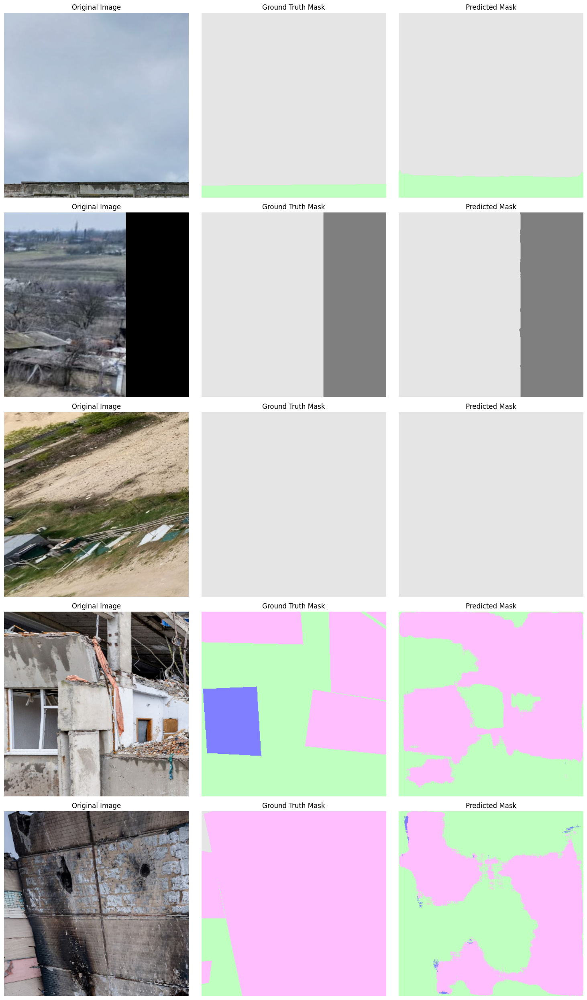


Epoch 2/20


Evaluating: 100%|██████████| 20/20 [00:34<00:00,  1.74s/it, Eval Loss=0.293]


Train Loss: 0.3844, Pixel Accuracy: 0.8701
Valid Loss: 0.3878, Pixel Accuracy: 0.8668
Validation loss decreased (0.5599 --> 0.3878).  Saving model ...


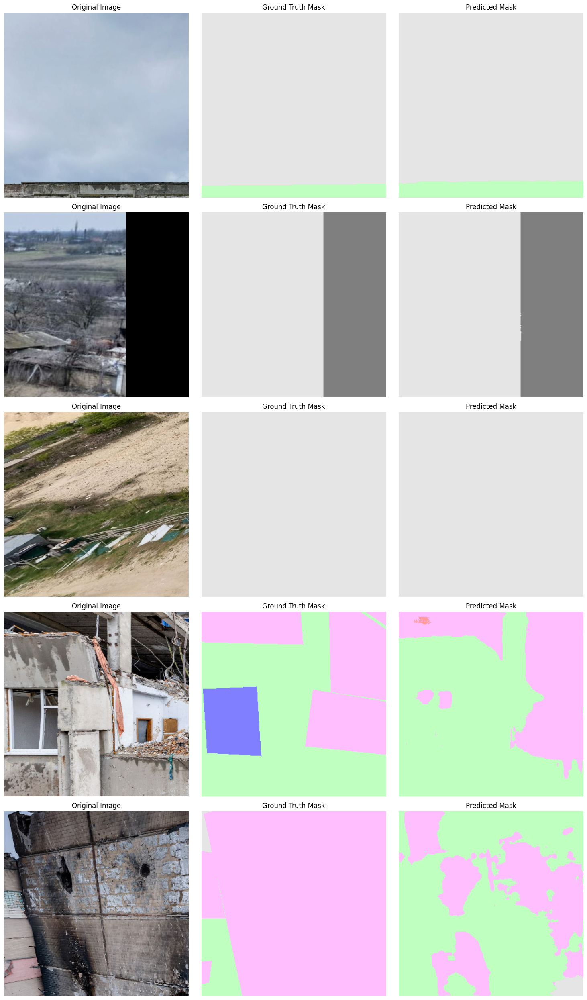


Epoch 3/20


Evaluating: 100%|██████████| 20/20 [00:29<00:00,  1.49s/it, Eval Loss=0.244]


Train Loss: 0.2735, Pixel Accuracy: 0.9072
Valid Loss: 0.2898, Pixel Accuracy: 0.9016
Validation loss decreased (0.3878 --> 0.2898).  Saving model ...


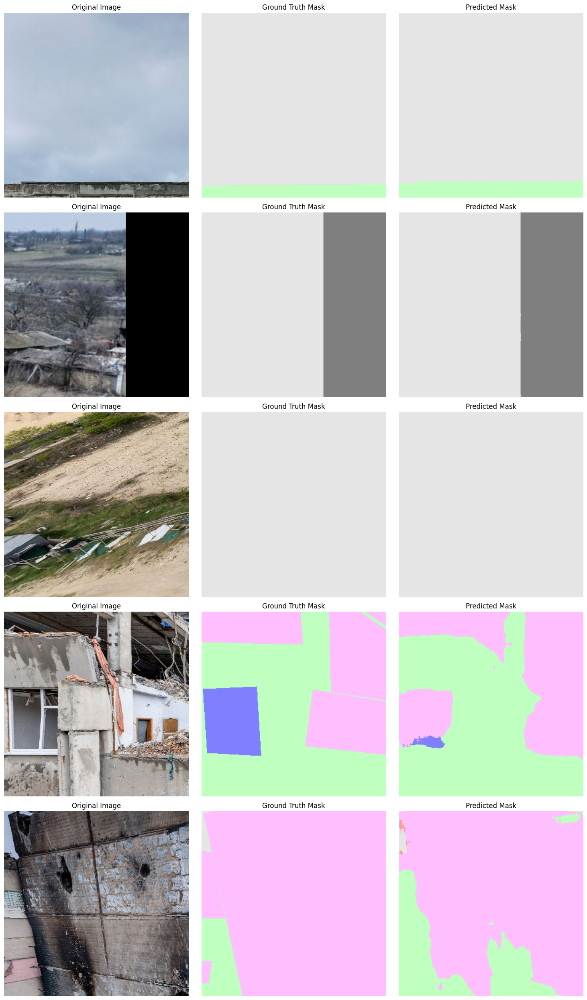


Epoch 4/20


Evaluating: 100%|██████████| 20/20 [00:29<00:00,  1.48s/it, Eval Loss=0.243]


Train Loss: 0.2077, Pixel Accuracy: 0.9284
Valid Loss: 0.2752, Pixel Accuracy: 0.9048
Validation loss decreased (0.2898 --> 0.2752).  Saving model ...


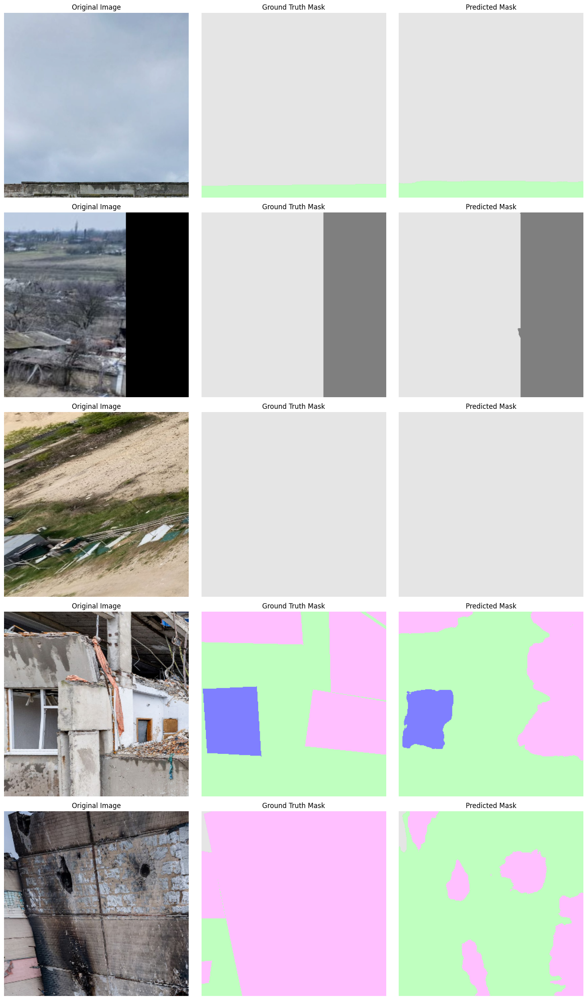


Epoch 5/20


Evaluating: 100%|██████████| 20/20 [00:29<00:00,  1.46s/it, Eval Loss=0.152]


Train Loss: 0.1584, Pixel Accuracy: 0.9453
Valid Loss: 0.2021, Pixel Accuracy: 0.9311
Validation loss decreased (0.2752 --> 0.2021).  Saving model ...


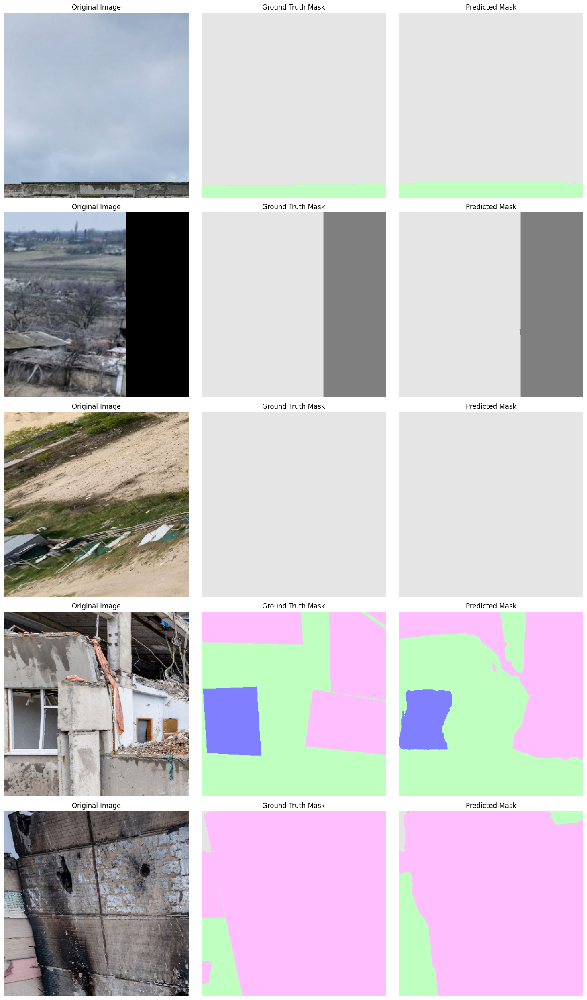


Epoch 6/20


Evaluating: 100%|██████████| 20/20 [00:28<00:00,  1.44s/it, Eval Loss=0.167]


Train Loss: 0.1304, Pixel Accuracy: 0.9543
Valid Loss: 0.1981, Pixel Accuracy: 0.9314
Validation loss decreased (0.2021 --> 0.1981).  Saving model ...


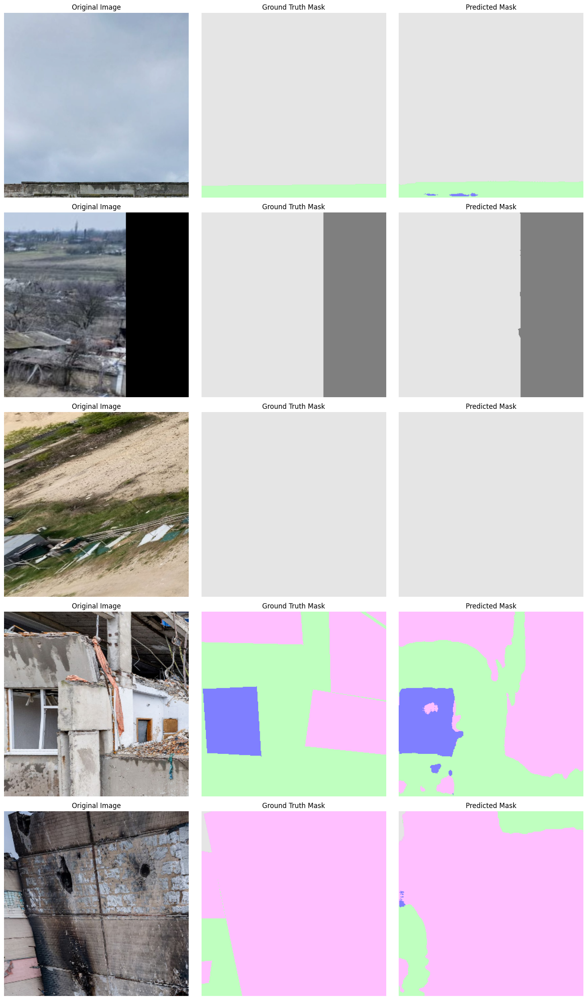


Epoch 7/20


Evaluating: 100%|██████████| 20/20 [00:30<00:00,  1.55s/it, Eval Loss=0.195]


Train Loss: 0.1107, Pixel Accuracy: 0.9611
Valid Loss: 0.1809, Pixel Accuracy: 0.9400
Validation loss decreased (0.1981 --> 0.1809).  Saving model ...


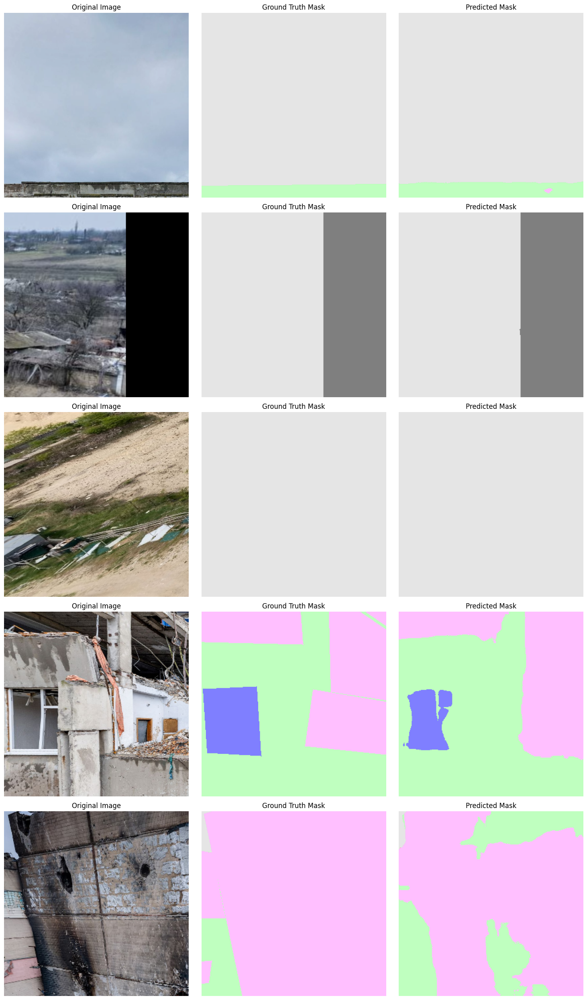


Epoch 8/20


Evaluating: 100%|██████████| 20/20 [00:29<00:00,  1.47s/it, Eval Loss=0.146]


Train Loss: 0.0918, Pixel Accuracy: 0.9674
Valid Loss: 0.1729, Pixel Accuracy: 0.9422
Validation loss decreased (0.1809 --> 0.1729).  Saving model ...


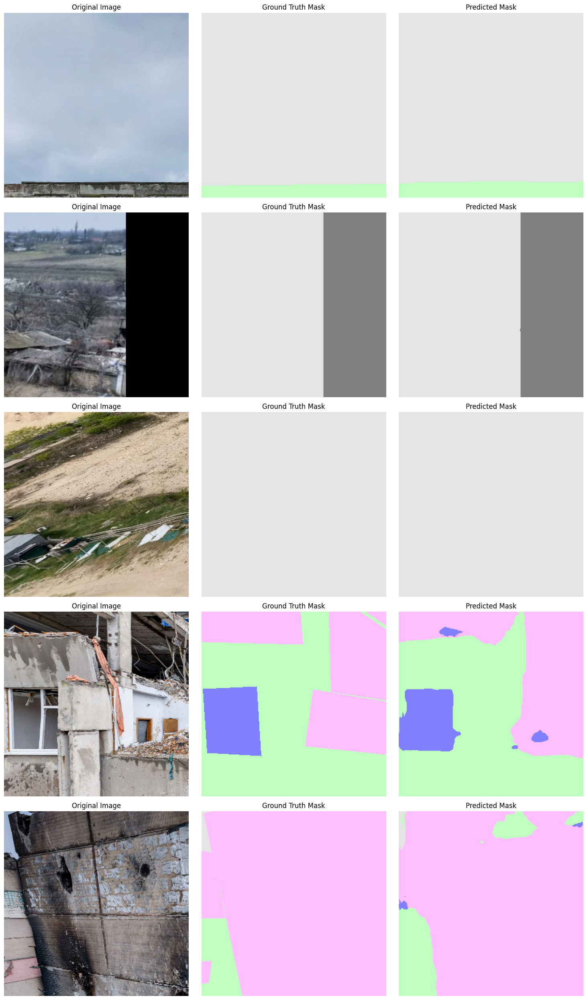


Epoch 9/20


Evaluating: 100%|██████████| 20/20 [00:31<00:00,  1.57s/it, Eval Loss=0.123]


Train Loss: 0.0820, Pixel Accuracy: 0.9707
Valid Loss: 0.1489, Pixel Accuracy: 0.9507
Validation loss decreased (0.1729 --> 0.1489).  Saving model ...


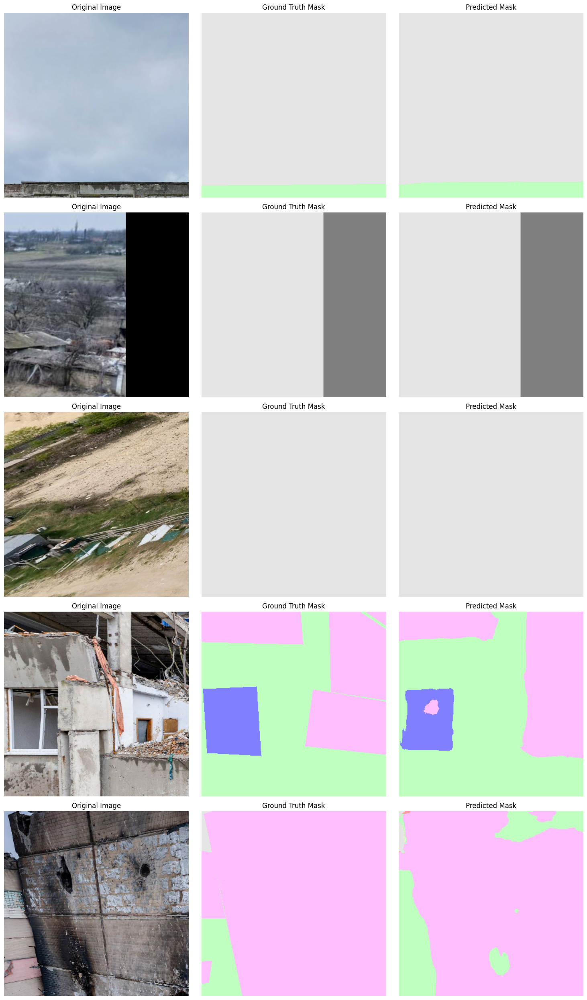


Epoch 10/20


Evaluating: 100%|██████████| 20/20 [00:32<00:00,  1.62s/it, Eval Loss=0.158]

Train Loss: 0.0811, Pixel Accuracy: 0.9712
Valid Loss: 0.1768, Pixel Accuracy: 0.9414


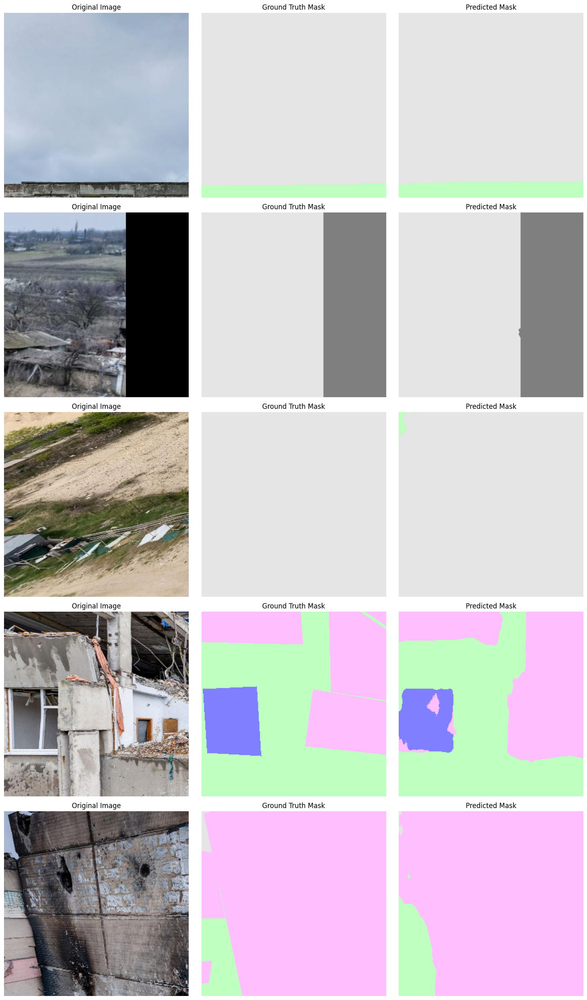


Epoch 11/20


Evaluating: 100%|██████████| 20/20 [00:32<00:00,  1.60s/it, Eval Loss=0.132]

Train Loss: 0.0869, Pixel Accuracy: 0.9691
Valid Loss: 0.1660, Pixel Accuracy: 0.9468


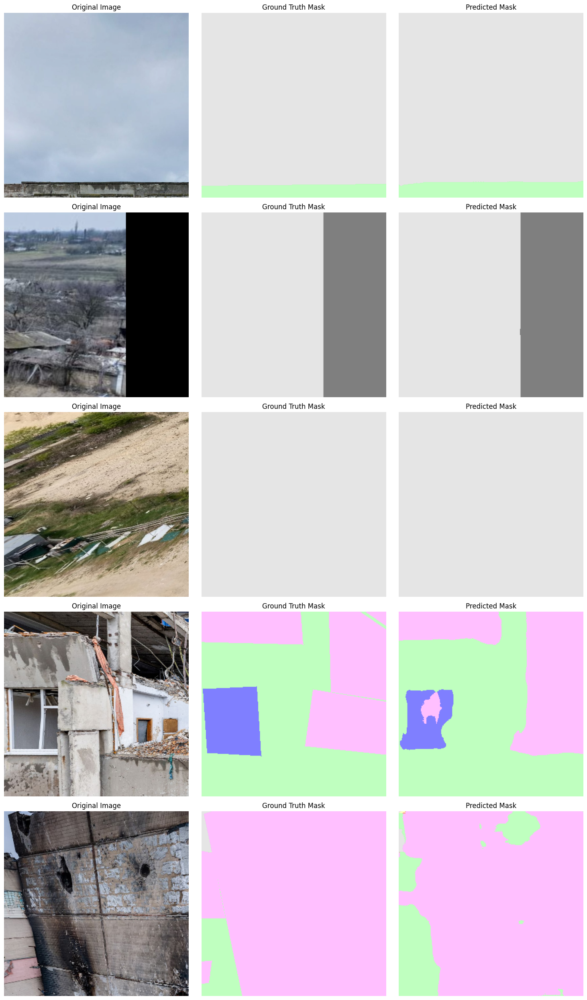


Epoch 12/20


Evaluating: 100%|██████████| 20/20 [00:34<00:00,  1.74s/it, Eval Loss=0.126]


Train Loss: 0.0664, Pixel Accuracy: 0.9759
Valid Loss: 0.1404, Pixel Accuracy: 0.9548
Validation loss decreased (0.1489 --> 0.1404).  Saving model ...


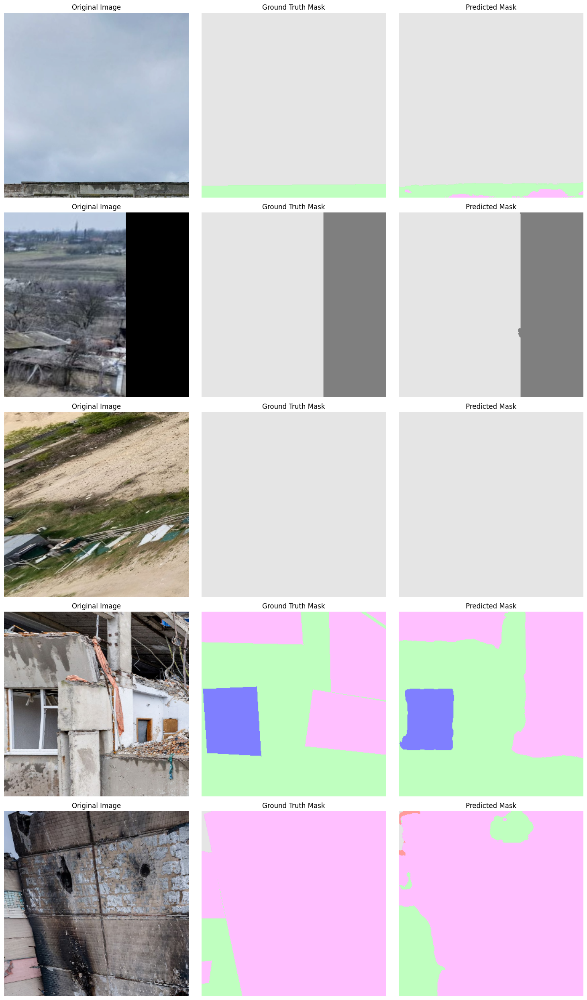


Epoch 13/20


Evaluating: 100%|██████████| 20/20 [00:34<00:00,  1.72s/it, Eval Loss=0.135]


Train Loss: 0.0595, Pixel Accuracy: 0.9783
Valid Loss: 0.1381, Pixel Accuracy: 0.9555
Validation loss decreased (0.1404 --> 0.1381).  Saving model ...


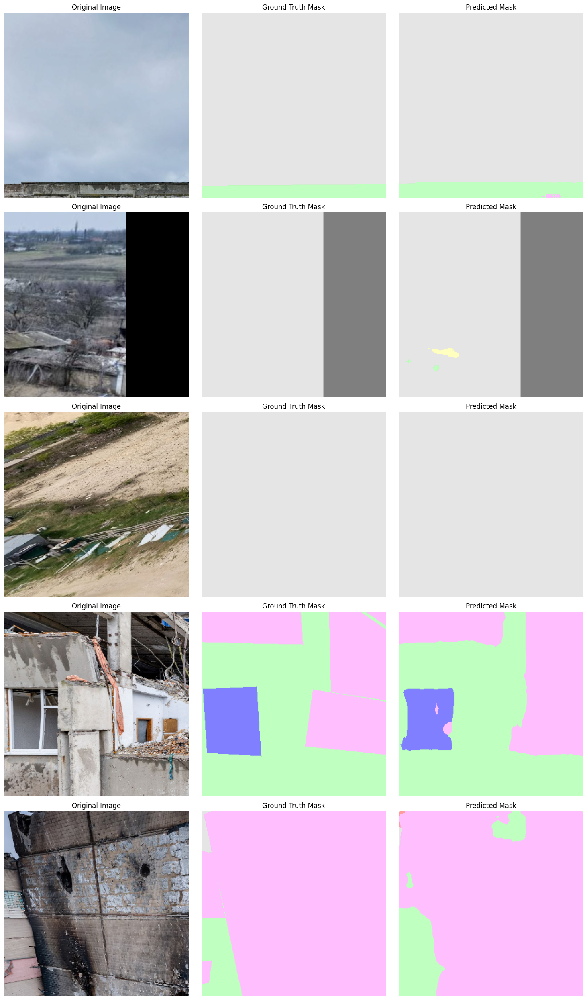


Epoch 14/20


Evaluating: 100%|██████████| 20/20 [00:32<00:00,  1.64s/it, Eval Loss=0.102]

Train Loss: 0.0551, Pixel Accuracy: 0.9799
Valid Loss: 0.1389, Pixel Accuracy: 0.9562


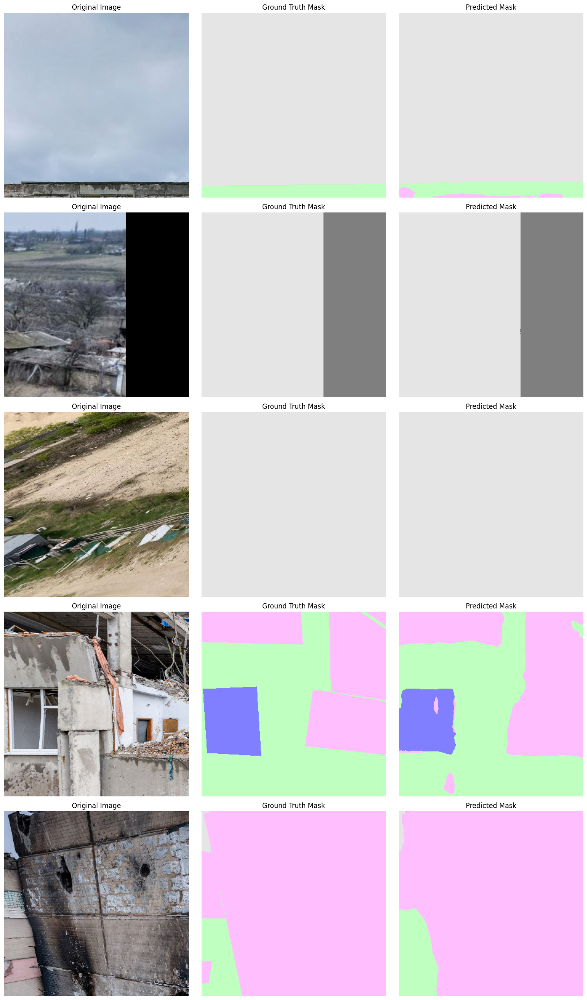


Epoch 15/20


Evaluating: 100%|██████████| 20/20 [00:35<00:00,  1.75s/it, Eval Loss=0.123]


Train Loss: 0.0513, Pixel Accuracy: 0.9811
Valid Loss: 0.1340, Pixel Accuracy: 0.9584
Validation loss decreased (0.1381 --> 0.1340).  Saving model ...


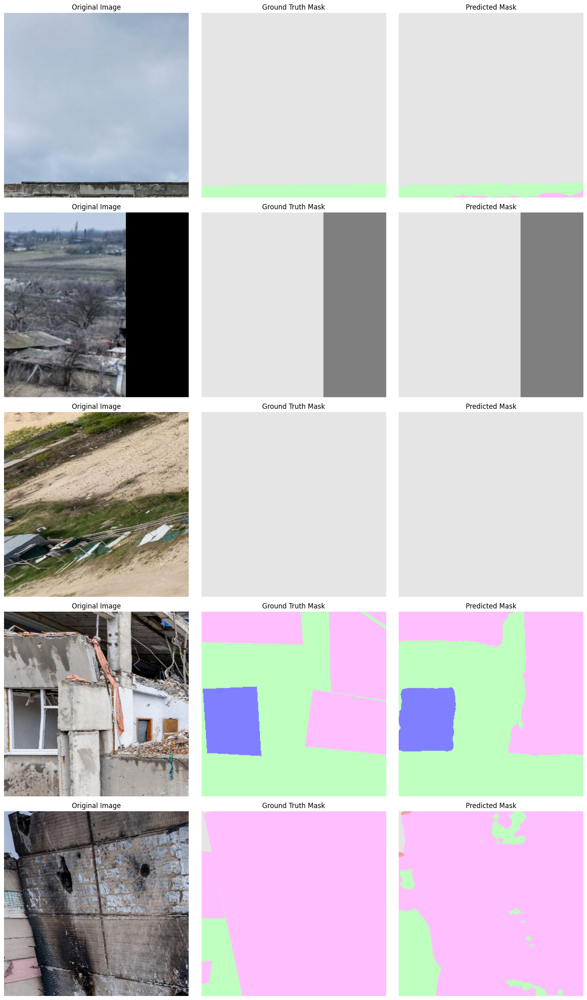


Epoch 16/20


Evaluating: 100%|██████████| 20/20 [00:34<00:00,  1.72s/it, Eval Loss=0.13]

Train Loss: 0.0514, Pixel Accuracy: 0.9811
Valid Loss: 0.1557, Pixel Accuracy: 0.9522


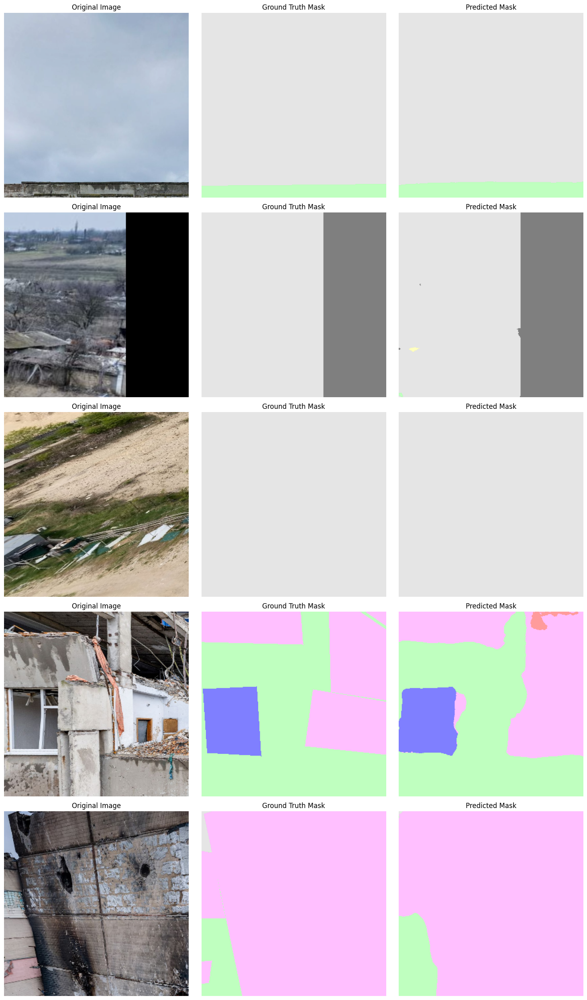


Epoch 17/20


Training Epoch:  55%|█████▌    | 86/155 [02:46<02:12,  1.92s/it, Loss=0.0531]

In [ ]:
set_seed(Config.seed)

# Number of classes (including background if applicable)
num_classes = len(label_mapping) + 1  # Assuming background is class 0

# Initialize the model
model = UNetTransferLearning(num_classes=num_classes).to(Config.device)

# Define the loss function and optimizer
criterion = nn.CrossEntropyLoss()

optimizer = optim.Adam(model.parameters(), lr=1e-3)

# Call the train function
metrics_history = train(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    train_loader=train_dataloader,
    valid_loader=val_dataloader,  # Using test_dataloader as validation loader
    device=Config.device,
    num_epochs=Config.num_epochs,
    logdir=Config.logdir
)

# Plot metrics

In [ ]:
def plot_metrics(metrics_history, num_classes, label_mapping):
    """
    Plot training and validation metrics over epochs, including per-class IoU and Dice.

    Args:
        metrics_history (dict): Dictionary containing training and validation metrics.
                                Expected keys: 'train_loss', 'valid_loss',
                                               'train_pixel_accuracy', 'valid_pixel_accuracy',
                                               'train_iou', 'valid_iou',
                                               'train_dice', 'valid_dice'.
        num_classes (int): Number of classes in the dataset (excluding background if applicable).
        label_mapping (dict): Mapping of class names to their indices.
    """
    epochs = np.arange(1, len(metrics_history['train_loss']) + 1)
    class_names = [name for name, idx in sorted(label_mapping.items(), key=lambda x: x[1])]

    # Plot Loss
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, metrics_history['train_loss'], label='Train Loss')
    plt.plot(epochs, metrics_history['valid_loss'], label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss')
    plt.legend()
    plt.grid()
    plt.show()

    # Plot Pixel Accuracy
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, metrics_history['train_pixel_accuracy'], label='Train Pixel Accuracy')
    plt.plot(epochs, metrics_history['valid_pixel_accuracy'], label='Validation Pixel Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Pixel Accuracy')
    plt.title('Training and Validation Pixel Accuracy')
    plt.legend()
    plt.grid()
    plt.show()

    # Plot IoU per class (Training)
    plt.figure(figsize=(12, 8))
    for class_idx, class_name in enumerate(class_names):
        class_iou = [epoch[class_idx] for epoch in metrics_history['train_iou']]
        plt.plot(epochs, class_iou, label=f'Train IoU: {class_name}')
    plt.xlabel('Epochs')
    plt.ylabel('IoU')
    plt.title('Training IoU per Class')
    plt.legend()
    plt.grid()
    plt.show()

    # Plot IoU per class (Validation)
    plt.figure(figsize=(12, 8))
    for class_idx, class_name in enumerate(class_names):
        class_iou = [epoch[class_idx] for epoch in metrics_history['valid_iou']]
        plt.plot(epochs, class_iou, label=f'Validation IoU: {class_name}')
    plt.xlabel('Epochs')
    plt.ylabel('IoU')
    plt.title('Validation IoU per Class')
    plt.legend()
    plt.grid()
    plt.show()

    # Plot Dice per class (Training)
    plt.figure(figsize=(12, 8))
    for class_idx, class_name in enumerate(class_names):
        class_dice = [epoch[class_idx] for epoch in metrics_history['train_dice']]
        plt.plot(epochs, class_dice, label=f'Train Dice: {class_name}')
    plt.xlabel('Epochs')
    plt.ylabel('Dice Coefficient')
    plt.title('Training Dice Coefficient per Class')
    plt.legend()
    plt.grid()
    plt.show()

    # Plot Dice per class (Validation)
    plt.figure(figsize=(12, 8))
    for class_idx, class_name in enumerate(class_names):
        class_dice = [epoch[class_idx] for epoch in metrics_history['valid_dice']]
        plt.plot(epochs, class_dice, label=f'Validation Dice: {class_name}')
    plt.xlabel('Epochs')
    plt.ylabel('Dice Coefficient')
    plt.title('Validation Dice Coefficient per Class')
    plt.legend()
    plt.grid()
    plt.show()

    # Plot Mean IoU
    plt.figure(figsize=(10, 6))
    train_iou = np.array(metrics_history['train_iou']).mean(axis=1)  # Average IoU across classes
    valid_iou = np.array(metrics_history['valid_iou']).mean(axis=1)
    plt.plot(epochs, train_iou, label='Train IoU (mean across classes)')
    plt.plot(epochs, valid_iou, label='Validation IoU (mean across classes)')
    plt.xlabel('Epochs')
    plt.ylabel('IoU')
    plt.title('Training and Validation Mean IoU')
    plt.legend()
    plt.grid()
    plt.show()

    # Plot Mean Dice Coefficient
    plt.figure(figsize=(10, 6))
    train_dice = np.array(metrics_history['train_dice']).mean(axis=1)  # Average Dice across classes
    valid_dice = np.array(metrics_history['valid_dice']).mean(axis=1)
    plt.plot(epochs, train_dice, label='Train Dice Coefficient (mean across classes)')
    plt.plot(epochs, valid_dice, label='Validation Dice Coefficient (mean across classes)')
    plt.xlabel('Epochs')
    plt.ylabel('Dice Coefficient')
    plt.title('Training and Validation Mean Dice Coefficient')
    plt.legend()
    plt.grid()
    plt.show()


In [ ]:
# Plot metrics
plot_metrics(metrics_history, model.num_classes, label_mapping)

# Predict images

In [ ]:
def predict_full_image(model, image, patch_size=(256, 256), stride=128, device='cuda'):
    model.eval()
    width, height = image.size
    pad_w = (patch_size[0] - width % stride) % stride
    pad_h = (patch_size[1] - height % stride) % stride
    padded_width = width + pad_w
    padded_height = height + pad_h

    # Pad the image
    image_padded = Image.new('RGB', (padded_width, padded_height))
    image_padded.paste(image, (0, 0))

    # Initialize arrays to hold predictions and counts
    full_probs = np.zeros((padded_height, padded_width, num_classes), dtype=np.float32)
    count_predictions = np.zeros((padded_height, padded_width), dtype=np.float32)

    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])

    with torch.no_grad():
        for y in range(0, padded_height - patch_size[1] + 1, stride):
            for x in range(0, padded_width - patch_size[0] + 1, stride):
                image_patch = image_padded.crop((x, y, x + patch_size[0], y + patch_size[1]))
                image_tensor = transform(image_patch).unsqueeze(0).to(device)

                output = model(image_tensor)  # Output shape: [1, num_classes, H, W]
                probs = torch.softmax(output, dim=1)  # Convert logits to probabilities
                probs = probs.squeeze(0).cpu().numpy()  # Shape: [num_classes, H, W]

                # Accumulate probabilities
                full_probs[y:y + patch_size[1], x:x + patch_size[0], :] += probs.transpose(1, 2, 0)
                count_predictions[y:y + patch_size[1], x:x + patch_size[0]] += 1

    # Average the probabilities where patches overlap
    full_probs /= np.expand_dims(count_predictions, axis=2)
    full_probs = full_probs[:height, :width, :]  # Remove padding
    final_prediction = np.argmax(full_probs, axis=2).astype(np.uint8)  # Shape: [H, W]

    return final_prediction


In [ ]:
def visualize_prediction_with_colors(image, prediction, color_mapping):
    """
    Visualize the predicted labels on the image using specified colors.

    Args:
        image (PIL.Image.Image): Original input image.
        prediction (np.ndarray): Predicted label mask of shape [H, W].
        color_mapping (dict): Dictionary mapping label IDs to RGBA colors.

    Returns:
        PIL.Image.Image: Visualization with the predicted labels overlaid on the image.
    """
    # Convert the image to RGBA mode to overlay semi-transparent colors
    image = image.convert("RGBA")
    overlay = Image.new("RGBA", image.size, (0, 0, 0, 0))
    draw = ImageDraw.Draw(overlay)

    # Overlay colors based on predictions
    height, width = prediction.shape
    for y in range(height):
        for x in range(width):
            label = prediction[y, x]
            if label in color_mapping:
                draw.point((x, y), fill=color_mapping[label])

    # Blend the original image with the overlay
    blended = Image.alpha_composite(image, overlay)
    return blended


In [ ]:
# Load the original image
image_path = 'img6.jpeg'
image = Image.open(image_path).convert("RGB")

# Load your trained model
model.load_state_dict(torch.load('best_model.pth'))
model.to(Config.device)

# Perform prediction using your model
prediction = predict_full_image(
    model=model,
    image=image,
    patch_size=Config.patch_size,
    stride=Config.stride,
    device=Config.device
)

# Visualize the prediction using the color mapping
visualized_image = visualize_prediction_with_colors(image, prediction, color_mapping)

# Show the result
visualized_image


Broken Window: **Blue**, Building: **Green**, Damage: **Purple**, Damaged roof: **Red**, Other: **Grey**, Roof: **Orange**

# Calculating accuracy

In [ ]:
def evaluate_test_set(model, test_loader, device='cuda'):
    """
    Evaluate segmentation model on the test set using patched images and masks.
    Computes pixel accuracy, IoU, and Dice metrics.

    Args:
        model (torch.nn.Module): Trained segmentation model.
        test_loader (DataLoader): DataLoader containing patched test data.
        device (str): Device to run the model on ('cuda' or 'cpu').

    Returns:
        dict: Dictionary containing average Pixel Accuracy, IoU, and Dice scores.
    """
    model.eval()  # Set the model to evaluation mode
    total_pixel_accuracy = 0
    iou_list = []
    dice_list = []
    num_images = 0

    with torch.no_grad():  # Disable gradient calculations for evaluation
        for imgs, masks in tqdm(test_loader, desc="Evaluating Test Set"):
            imgs = imgs.to(device)  # Move images to device
            masks = masks.cpu().numpy()  # Ground truth masks on CPU

            # Forward pass
            outputs = model(imgs)  # Shape: [batch_size, num_classes, H, W]
            preds = torch.argmax(outputs, dim=1).cpu().numpy()  # Get predicted masks (batch_size, H, W)

            # Calculate metrics for each image in the batch
            for pred, true_mask in zip(preds, masks):
                pixel_accuracy = calculate_pixel_accuracy(pred, true_mask)
                iou = calculate_iou(pred, true_mask, model.num_classes)
                dice = calculate_dice(pred, true_mask, model.num_classes)

                total_pixel_accuracy += pixel_accuracy
                iou_list.append(iou)
                dice_list.append(dice)
                num_images += 1

    # Average metrics
    avg_pixel_accuracy = total_pixel_accuracy / num_images
    avg_iou = np.nanmean(iou_list, axis=0)  # Ignore NaNs for classes with no ground truth
    avg_dice = np.nanmean(dice_list, axis=0)

    print("\nEvaluation Metrics:")
    print(f"Pixel Accuracy: {avg_pixel_accuracy:.4f}")
    print(f"IoU per class: {avg_iou}")
    print(f"Dice per class: {avg_dice}")

    return {
        "Pixel Accuracy": avg_pixel_accuracy,
        "IoU": avg_iou,
        "Dice": avg_dice
    }

In [ ]:
model = UNetTransferLearning(num_classes=num_classes).to(Config.device)
model.load_state_dict(torch.load('best_model.pth'))

metrics = evaluate_test_set(
    model=model,
    test_loader=test_dataloader,
    device=Config.device,
)

In [ ]:
classes = [
    'Background',
    'Broken Window',
    'Building',
    'Damage',
    'Damaged roof',
    'Other',
    'Roof'
    ]

print(f"Pixel Accuracy: {metrics['Pixel Accuracy']:.4f}")
for cls_idx, (iou, dice) in enumerate(zip(metrics["IoU"], metrics["Dice"])):
    print(f"Class {classes[cls_idx]}: IoU: {iou:.4f}, Dice: {dice:.4f}")

print(f"Mean IoU: {np.mean(metrics['IoU']):.4f}")
print(f"Mean Dice: {np.mean(metrics['Dice']):.4f}")

{'Broken Window': 1, 'Building': 2, 'Damage': 3, 'Damaged roof': 4, 'Other': 5, 'Roof': 6}